In [1]:
import pandas as pd
import numpy as np
import matplotlib as mpl

import matplotlib.pyplot as plt


In [2]:
df = pd.read_excel('data.xlsx')

In [3]:
df

,ВремяГТИ,Глубина БК,"Блок, м","Вес, т","Расход, л/с","Давление, атм"
0,2022-01-18 12:00:00,13.29,8.16,0.00,0.0,0.0
1,2022-01-18 12:00:05,13.29,8.38,0.00,0.0,0.0
2,2022-01-18 12:00:10,13.29,8.57,0.37,0.0,0.0
3,2022-01-18 12:00:15,13.29,8.57,0.23,0.0,0.0
4,2022-01-18 12:00:20,13.29,8.67,0.00,0.0,0.0
...,...,...,...,...,...,...
55321,2022-01-22 02:25:05,2531.66,2.21,0.00,0.0,0.0
55322,2022-01-22 02:25:10,2531.66,2.21,0.00,0.0,0.0
55323,2022-01-22 02:25:15,2531.66,2.22,0.00,0.0,0.0
55324,2022-01-22 02:25:20,2531.63,2.29,37.17,0.0,0.0


## Задание 2
_______________________

In [4]:
time_up = 0
time_down = 0
velocity_sum_up = 0
velocity_sum_down = 0
counter_up = 0
counter_down = 0
df['ВремяГТИ'] = pd.to_datetime(df['ВремяГТИ'])


velos_up = []
velos_down = []
velocity = [0]*df.shape[0]
time_up = []
time_down = []

for i in range(1, df.shape[0]):
    delta = df['Блок, м'][i]-df['Блок, м'][i-1]
    delta_time  = (df['ВремяГТИ'][i]-df['ВремяГТИ'][i-1]).total_seconds()
    if delta<-0.2:
        velos_down.append(np.abs(delta/5))
        time_down.append(delta_time)
    elif delta>0.21:
        velos_up.append(np.abs(delta/5))
        time_up.append(delta_time)
    velocity[i] = delta/delta_time

avg_up = sum(velos_up)/len(velos_up)
avg_down = sum(velos_down)/len(velos_down)
df['velocity'] = velocity

print(f'средняя скорость спуска: {avg_down}')
print(f'средняя скорость подъема: {np.abs(avg_up)}')  
data= {'Средняя скорость спуска': [avg_down], 'Средняя скорость подъема': [avg_up]}
dataset = pd.DataFrame(data=data)
dataset.to_excel('result.xlsx', index=False)


средняя скорость спуска: 0.08935888601779997
средняя скорость подъема: 0.19244469653998805


## Задание 3
_______________________

In [5]:
print(df.shape[0])

diff = [0]*df.shape[0]
for i in range(1,df.shape[0]):
    diff[i] = df['Блок, м'][i]-df['Блок, м'][i-1]

df['diff'] = diff

df_up = df[df['diff']>0]
df_down = df[df['diff']<0]

55326


In [6]:
# _df_up = df_up.groupby('Глубина БК')[['Вес, т']].mean()
# _df_up

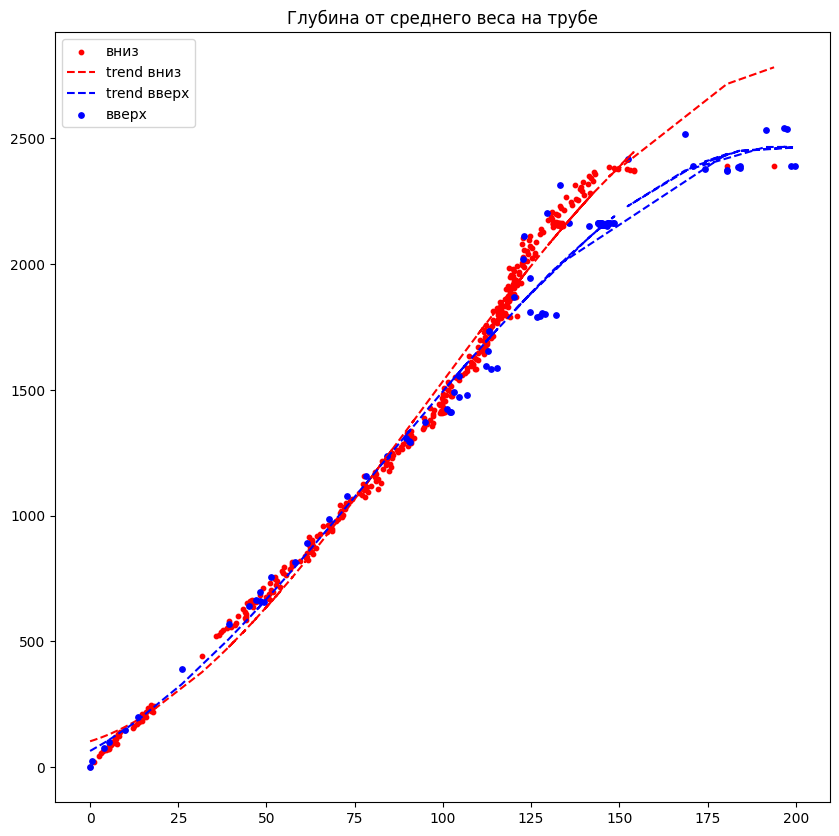

In [20]:


_df_up = df_up.groupby('Глубина БК')[['Вес, т']].mean()


count = 0
sum_deep = 0
deeps_up = [0]
weights_up = [0]
sum_weight = 0
average_by = 15
for i in _df_up.index:
    if _df_up['Вес, т'][i]>weights_up[-1]*0.8:
#         print((_df_up['Вес, т'][i]-weights_up[-1]))
        if count<=average_by-1:
            count+=1
            sum_weight+=_df_up['Вес, т'][i]
            sum_deep+=i
        else:
            weights_up.append(sum_weight/average_by)
            deeps_up.append(sum_deep/average_by)
            count=0
            sum_weight=0
            sum_deep=0


_df_down = df_down.groupby('Глубина БК')[['Вес, т']].mean()
count = 0
sum_deep = 0
deeps_down = [0]
weights_down = [0]
sum_weight = 0

for i in _df_down.index:
    if _df_down['Вес, т'][i]>weights_down[-1]*0.9:
        if count<=average_by-1:
            count+=1
            sum_weight+=_df_down['Вес, т'][i]
            sum_deep+=i
        else:
            weights_down.append(sum_weight/average_by)
            deeps_down.append(sum_deep/average_by)
            count=0
            sum_weight=0
            sum_deep=0


# mpl.rcParams["keymap.home"]='home'


plt.figure(figsize=(10,10))
z = np.polyfit(weights_down, deeps_down, 3)
p = np.poly1d(z)
plt.scatter(weights_down, deeps_down, color='red',label='вниз', s=10)
plt.plot(weights_down, p(weights_down), "r--",label='trend вниз')
z = np.polyfit(weights_up, deeps_up, 3)
p = np.poly1d(z)

plt.plot(weights_up,p(weights_up), "b--", label='trend вверх')
plt.scatter(weights_up, deeps_up, color='blue',label='вверх', s=15)
# plt.style.use(['keymap.home'])
# plt.style.use(mpl.keymap.home())
plt.legend()


plt.title('Глубина от среднего веса на трубе')
plt.show()

In [8]:
import plotly.express as px

In [9]:
fig = px.scatter(x=df['ВремяГТИ'],y=df['Вес, т'], trendline="ols",
                 trendline_color_override="red", 
                 title='Вес блока от времени',
                labels = {'x': 'Время', 'y':'Вес'})

fig.show()

In [10]:
fig = px.scatter(x=df['ВремяГТИ'],y=df['Глубина БК'], trendline="ols",
                 trendline_color_override="red", 
                 title='Вес блока от времени',
                labels = {'x': 'Время', 'y':'Вес'})

fig.show()